In [1]:
# Install the required library for YOLOv8
!pip install ultralytics

In [4]:
# Import necessary libraries
import os
import cv2
import glob
import yaml
import random
import pathlib
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
from tqdm import tqdm
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm.notebook import trange, tqdm
from IPython.display import Image, display, Video
from sklearn.metrics import precision_score, recall_score
import mlflow
import mlflow.pytorch

# Disable WANDB (Weights & Biases) logging to avoid unnecessary clutter
!wandb disabled

# Suppress warnings for cleaner outputs
import warnings
warnings.filterwarnings('ignore')
# Enable MLflow logging
mlflow.set_tracking_uri("./mlruns")
mlflow.set_experiment("YOLOv8_Object_Detection")

'wandb' is not recognized as an internal or external command,
operable program or batch file.


<Experiment: artifact_location='file:c:/Users/arnav.shah/Desktop/Task2/mlruns/807863234713662408', creation_time=1743494637616, experiment_id='807863234713662408', last_update_time=1743494637616, lifecycle_stage='active', name='YOLOv8_Object_Detection', tags={}>

In [58]:
# Define paths for train, validation, and test image datasets
train_path =r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\train"
val_path = r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\valid"
test_path =r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\test"
yaml_path=r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\dataset.yaml"

In [8]:
# Read and display the class names from the YAML file
with open(yaml_path, 'r') as file:
    data = yaml.safe_load(file)
class_names = data['names']
print(f"Class Names: {class_names}")

Class Names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck', 'Person']


In [6]:
import os
import random
from PIL import Image

# Path to the images folder
images_folder = r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\train\images"

# Get list of image files
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Select a random image
random_image = random.choice(image_files)
random_image_path = os.path.join(images_folder, random_image)

# Open the image
image = Image.open(random_image_path)

# Display image properties
print(f"Random Image: {random_image}")
print(f"Image Size: {image.size}")  # (width, height)
print(f"Image Mode: {image.mode}")  # e.g., RGB, L, etc.
print(f"Number of Channels: {len(image.getbands())}")  # RGB -> 3, Grayscale -> 1

# Show the image (optional)
image.show()


Random Image: fa4373131d980682_jpg.rf.fb4066e24ca14b29bcee16051cec2834.jpg
Image Size: (416, 416)
Image Mode: RGB
Number of Channels: 3


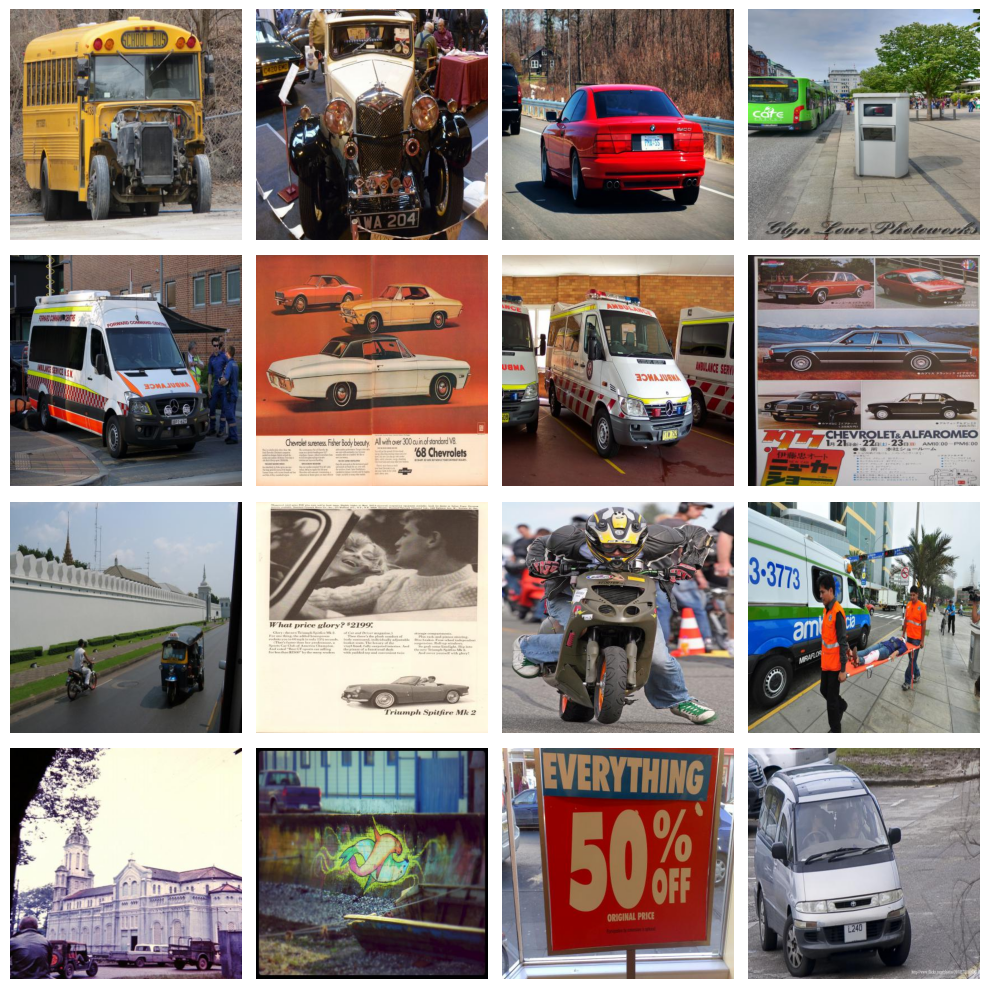

<Figure size 640x480 with 0 Axes>

In [7]:
%matplotlib inline
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Set the local images folder path
images_folder =r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\train\images"

# Get a list of image files from the folder
image_files = [f for f in os.listdir(images_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Visualize a grid of 16 random images from the training dataset
selected_images = random.sample(image_files, 16)
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
for i, ax in enumerate(axes.flat):
    img_path = os.path.join(images_folder, selected_images[i])
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.axis('off')  # Hide axes for a cleaner look

plt.tight_layout()
plt.show()

# Optionally, save the figure to disk for verification
plt.savefig(r"C:\Users\arnav.shah\Desktop\grid_output.png")



In [31]:
# Load YOLOv8 model for inference
model = YOLO("yolov8l.pt")  # Load pre-trained YOLOv8 model


0: 416x416 3 cars, 230.7ms
1: 416x416 1 bus, 230.7ms
2: 416x416 1 cake, 230.7ms
3: 416x416 1 person, 1 bus, 230.7ms
Speed: 1.8ms preprocess, 230.7ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 416)


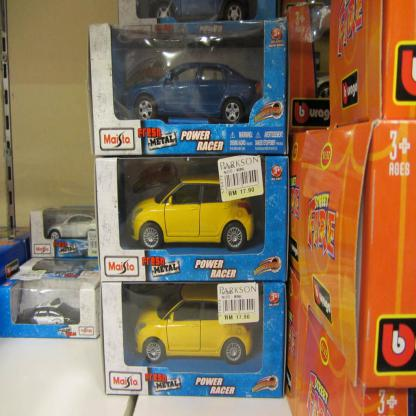

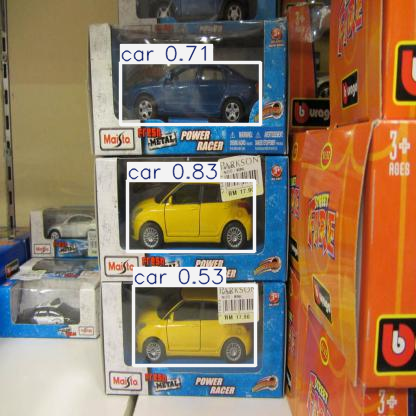

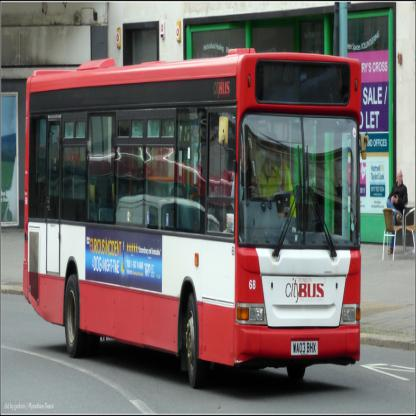

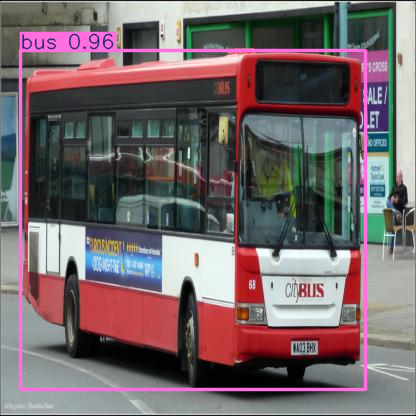

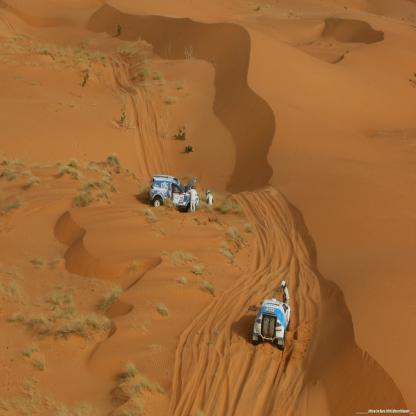

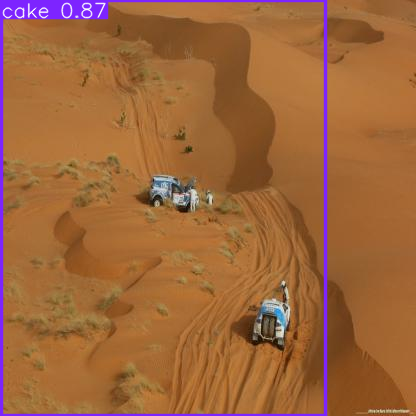

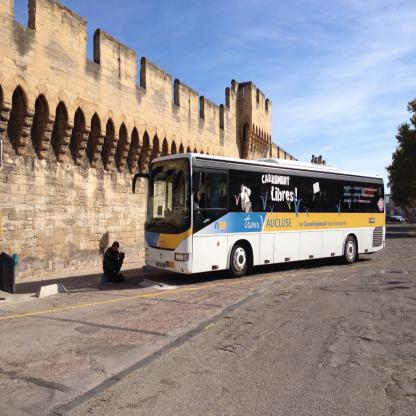

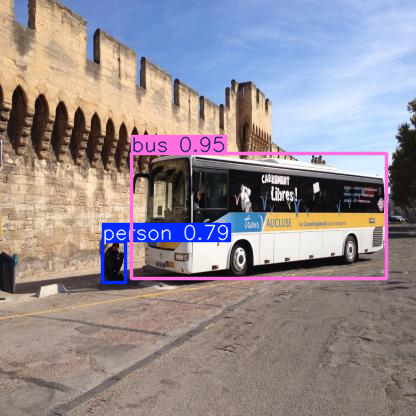

In [9]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
from IPython.display import display

# Set the local images folder path
images_folder = r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\test\images"

# Get a list of image files from the folder
image_files = [f for f in os.listdir(images_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Randomly select a smaller number of images (e.g., 4) for testing
selected_images = random.sample(image_files, 4)
selected_paths = [os.path.join(images_folder, img) for img in selected_images]

# Predict on the batch of images
# Ensure your model is set to use the proper device (e.g., GPU if available)
results = model.predict(source=selected_paths, imgsz=416, conf=0.5, iou=0.6)

# Display the results for each image
for i, image_path in enumerate(selected_paths):
    original_image = Image.open(image_path)
    display(original_image)  # Display the original image
    # Display the prediction result (assuming result.plot() returns an image array)
    plot = results[i].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))


In [ ]:
"""import mlflow

# Assuming you already know the run ID of your YOLOv8n training run
run_id = "your_run_id_here"  # Replace with your actual run ID
model_uri = f"runs:/{run_id}/weights/last.pt"  # Path to the saved model (artifact)
model_name = "YOLOv8n_model"  # The name you want to register the model under

# Register the model in MLflow's Model Registry
registered_model = mlflow.register_model(model_uri, model_name)

# Optionally, you can set the stage (e.g., "Production") for the model
mlflow.set_registered_model_version_stage(registered_model.name, registered_model.version, stage="Production")

print(f"Model registered with name: {registered_model.name}, version: {registered_model.version}")
"""

In [5]:
import mlflow
from ultralytics import YOLO
import os

# Set correct experiment name
experiment_name = "YOLOv8l_Object_Detection"  # Use a valid experiment name
mlflow.set_tracking_uri("file:///C:/Users/arnav.shah/Desktop/Task2/mlruns")
mlflow.set_experiment(experiment_name)  # Ensure a valid experiment is set

def train_and_register_yolo():
    output_path = r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\dataset.yaml"
    checkpoint_dir = "runs/train"  # Directory where YOLO saves checkpoints
    
    # Check for latest checkpoint for YOLOv8l
    latest_checkpoint = None
    if os.path.exists(checkpoint_dir):
        exp_dirs = sorted(os.listdir(checkpoint_dir), reverse=True)
        for exp in exp_dirs:
            ckpt_path = os.path.join(checkpoint_dir, exp, "weights", "last.pt")
            if os.path.exists(ckpt_path):
                latest_checkpoint = ckpt_path
                break

    try:
        with mlflow.start_run() as run:
            # Load model from checkpoint if available
            if latest_checkpoint:
                print(f"Resuming training from checkpoint: {latest_checkpoint}")
                model = YOLO(latest_checkpoint)
            else:
                print("Starting YOLOv8l training from scratch...")
                model = YOLO("yolov8l.yaml").load("yolov8l.pt")  # Changed to YOLOv8l
            
            # Debug: Print model structure
            print(f"Model loaded: {model}")
            
            results = model.train(
                data=output_path,
                epochs=50,
                imgsz=640,  # YOLOv8l generally performs better with larger image sizes
                batch=8,
                lr0=0.002,
                dropout=0.2,
                device="cpu",  # Change to "cuda" if GPU is available
                resume=bool(latest_checkpoint)
            )
            
            # Debug: Check if results are logged
            print(f"Training results: {results}")
            
            # Log key parameters
            mlflow.log_param("model_type", "YOLOv8l")
            mlflow.log_param("epochs", 50)
            mlflow.log_param("image_size", 640)  # Updated for larger image size
            mlflow.log_param("batch_size", 8)
            mlflow.log_param("learning_rate", 0.002)
            mlflow.log_param("resume", bool(latest_checkpoint))
            
            # Save the trained model
            model_dir = "yolo_model"
            os.makedirs(model_dir, exist_ok=True)
            model_weights_path = os.path.join(model_dir, "best.pt")
            model.save(model_weights_path)  # Save the best model

            # Log model weights as an artifact
            mlflow.log_artifact(model_weights_path)
            print("✅ Model weights logged to MLflow!")

            # Register the model in MLflow
            model_name = "YOLOv8l_Vehicle_Detection"
            model_uri = f"runs:/{run.info.run_id}/{model_weights_path}"
            mlflow.register_model(model_uri, model_name)
            
            print(f"✅ Model registered in MLflow as '{model_name}'")

            # Ensure MLflow logging was successful
            print(f"Run ID: {mlflow.active_run().info.run_id}")

    except Exception as e:
        print(f"Error during training and model registration: {e}")

# Call the function to start training and register model
train_and_register_yolo()




2025/04/02 03:20:38 INFO mlflow.tracking.fluent: Experiment with name 'YOLOv8l_Object_Detection' does not exist. Creating a new experiment.
2025/04/02 03:20:38 WARNING mlflow.utils.git_utils: Failed to import Git (the Git executable is probably not on your PATH), so Git SHA is not available. Error: Failed to initialize: Bad git executable.
The git executable must be specified in one of the following ways:
    - be included in your $PATH
    - be set via $GIT_PYTHON_GIT_EXECUTABLE
    - explicitly set via git.refresh(<full-path-to-git-executable>)

All git commands will error until this is rectified.

This initial message can be silenced or aggravated in the future by setting the
$GIT_PYTHON_REFRESH environment variable. Use one of the following values:
    - quiet|q|silence|s|silent|none|n|0: for no message or exception
    - warn|w|warning|log|l|1: for a warning message (logging level CRITICAL, displayed by default)
    - error|e|exception|raise|r|2: for a raised exception

Example:
 

Starting YOLOv8l training from scratch...
Transferred 595/595 items from pretrained weights
Model loaded: YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(320, 128, kernel_size=(1, 1), 

train: Scanning C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\train\labels.cache... 878 images, 1530 backgrounds, 0 corrupt: 100%|██████████| 2408/2408 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


c:\Users\arnav.shah\AppData\Local\Programs\Python\Python313\Lib\site-packages\albumentations\__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\valid\labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs\detect\train7\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.002' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)


2025/04/02 03:20:45 INFO mlflow.tracking.fluent: Experiment with name '/Shared/Ultralytics' does not exist. Creating a new experiment.


MLflow: logging run_id(1631d5364abb487b8e5a71a34595c6cb) to file:///C:/Users/arnav.shah/Desktop/Task2/mlruns
MLflow: disable with 'yolo settings mlflow=False'
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train7
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.576      3.452      1.849         12        640: 100%|██████████| 301/301 [1:35:09<00:00, 18.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [04:23<00:00, 16.48s/it]

                   all        250        454    0.00286      0.257    0.00216   0.000668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      2.131      3.877      2.312          8        640: 100%|██████████| 301/301 [1:47:11<00:00, 21.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.54s/it]

                   all        250        454    0.00236       0.41    0.00506    0.00112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      2.125      4.016      2.329          9        640: 100%|██████████| 301/301 [1:39:07<00:00, 19.76s/it]   
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.62s/it]

                   all        250        454      0.206    0.00835     0.0121    0.00373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G      2.048      3.881      2.248          9        640: 100%|██████████| 301/301 [1:32:12<00:00, 18.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:25<00:00, 12.85s/it]

                   all        250        454     0.0056      0.658     0.0179    0.00572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      1.874      3.738      2.109         15        640: 100%|██████████| 301/301 [1:33:05<00:00, 18.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [04:29<00:00, 16.84s/it]

                   all        250        454     0.0234      0.381     0.0427     0.0153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      1.835      3.559       2.07          3        640: 100%|██████████| 301/301 [1:34:09<00:00, 18.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [04:05<00:00, 15.32s/it]

                   all        250        454      0.384     0.0696      0.061     0.0278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      1.704      3.433      1.977          8        640: 100%|██████████| 301/301 [1:38:18<00:00, 19.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:11<00:00, 11.96s/it]

                   all        250        454      0.246      0.107     0.0327     0.0144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G       1.67      3.337      1.943         14        640: 100%|██████████| 301/301 [1:30:27<00:00, 18.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.54s/it]

                   all        250        454      0.314      0.057     0.0675     0.0319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G      1.629      3.212      1.903          6        640: 100%|██████████| 301/301 [1:30:18<00:00, 18.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:23<00:00, 12.71s/it]

                   all        250        454      0.362      0.181      0.138     0.0648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G      1.572      3.121       1.86          8        640: 100%|██████████| 301/301 [1:31:39<00:00, 18.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:19<00:00, 12.44s/it]

                   all        250        454      0.333      0.103     0.0911     0.0431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      1.554      3.064      1.841         10        640: 100%|██████████| 301/301 [1:30:04<00:00, 17.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.55s/it]

                   all        250        454      0.283      0.181      0.106     0.0481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G      1.539      2.981      1.838          7        640: 100%|██████████| 301/301 [1:28:41<00:00, 17.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.56s/it]

                   all        250        454     0.0883      0.202     0.0901     0.0438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G      1.477      2.881       1.77          6        640: 100%|██████████| 301/301 [1:32:03<00:00, 18.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.61s/it]

                   all        250        454      0.197      0.198      0.153      0.083



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      1.507      2.905      1.781          5        640: 100%|██████████| 301/301 [1:31:59<00:00, 18.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:22<00:00, 12.68s/it]

                   all        250        454      0.181       0.27      0.173     0.0851



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G      1.471      2.829       1.76         16        640: 100%|██████████| 301/301 [1:32:42<00:00, 18.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:22<00:00, 12.64s/it]

                   all        250        454      0.177      0.271      0.174     0.0973



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G      1.459      2.806      1.764         14        640: 100%|██████████| 301/301 [1:25:53<00:00, 17.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:07<00:00, 11.69s/it]

                   all        250        454      0.197      0.299      0.167      0.097



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G      1.402       2.77       1.71         15        640: 100%|██████████| 301/301 [1:32:29<00:00, 18.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:22<00:00, 12.66s/it]

                   all        250        454      0.231       0.27      0.181      0.106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G      1.389      2.699      1.704          9        640: 100%|██████████| 301/301 [1:32:14<00:00, 18.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.59s/it]

                   all        250        454       0.23      0.315      0.175      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G      1.366      2.683      1.695          2        640: 100%|██████████| 301/301 [1:31:45<00:00, 18.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:22<00:00, 12.64s/it]

                   all        250        454      0.298      0.353      0.231      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      1.358      2.615      1.674          4        640: 100%|██████████| 301/301 [1:32:00<00:00, 18.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:23<00:00, 12.72s/it]

                   all        250        454      0.212      0.361      0.215      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G      1.336      2.552      1.661         11        640: 100%|██████████| 301/301 [1:32:39<00:00, 18.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:22<00:00, 12.63s/it]

                   all        250        454      0.284      0.327      0.246      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G      1.342      2.555      1.667          7        640: 100%|██████████| 301/301 [1:33:11<00:00, 18.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:25<00:00, 12.86s/it]

                   all        250        454      0.298      0.312      0.254      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G       1.29       2.56      1.634          6        640: 100%|██████████| 301/301 [1:30:44<00:00, 18.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:09<00:00, 11.81s/it]

                   all        250        454      0.295      0.324      0.253      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G      1.316      2.508      1.638         12        640: 100%|██████████| 301/301 [1:35:28<00:00, 19.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [04:03<00:00, 15.22s/it]

                   all        250        454      0.261      0.324      0.252       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G      1.281       2.39      1.614         13        640: 100%|██████████| 301/301 [1:35:58<00:00, 19.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.52s/it]

                   all        250        454      0.218      0.299      0.242      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G      1.269      2.379      1.606          5        640: 100%|██████████| 301/301 [1:31:35<00:00, 18.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:19<00:00, 12.47s/it]

                   all        250        454      0.238       0.38      0.255      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G      1.261       2.35      1.592          9        640: 100%|██████████| 301/301 [1:31:47<00:00, 18.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.54s/it]

                   all        250        454      0.299      0.308      0.273      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      1.251      2.347       1.59         15        640: 100%|██████████| 301/301 [1:32:36<00:00, 18.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:23<00:00, 12.75s/it]

                   all        250        454      0.334      0.327      0.303      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G      1.225      2.265      1.581         15        640: 100%|██████████| 301/301 [1:31:08<00:00, 18.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:05<00:00, 11.60s/it]

                   all        250        454      0.253      0.423      0.275      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G      1.208      2.291      1.554         14        640: 100%|██████████| 301/301 [1:30:17<00:00, 18.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.54s/it]

                   all        250        454      0.573      0.322      0.318      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G      1.249      2.277      1.588          9        640: 100%|██████████| 301/301 [1:31:39<00:00, 18.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.54s/it]

                   all        250        454      0.289      0.335      0.267      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G      1.182      2.185      1.539         14        640: 100%|██████████| 301/301 [1:31:30<00:00, 18.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:19<00:00, 12.46s/it]

                   all        250        454      0.367      0.407      0.354      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      1.203      2.213      1.546          6        640: 100%|██████████| 301/301 [1:30:44<00:00, 18.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:18<00:00, 12.39s/it]

                   all        250        454      0.315      0.355      0.295      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G      1.171       2.19      1.531          8        640: 100%|██████████| 301/301 [1:30:45<00:00, 18.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:20<00:00, 12.55s/it]

                   all        250        454      0.345       0.42      0.329      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G      1.137      2.185      1.512         13        640: 100%|██████████| 301/301 [1:30:47<00:00, 18.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.60s/it]

                   all        250        454      0.256      0.435      0.336      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G      1.118      2.088      1.485          7        640: 100%|██████████| 301/301 [1:45:00<00:00, 20.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:58<00:00, 14.93s/it]

                   all        250        454      0.364      0.326      0.326      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G      1.125      2.042      1.491          7        640: 100%|██████████| 301/301 [1:36:34<00:00, 19.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:21<00:00, 12.57s/it]

                   all        250        454      0.336       0.41      0.346      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      1.115      2.016      1.497         19        640: 100%|██████████| 301/301 [1:33:35<00:00, 18.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:23<00:00, 12.71s/it]

                   all        250        454      0.327      0.437      0.351      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      1.065      1.951       1.46          6        640: 100%|██████████| 301/301 [1:24:10<00:00, 16.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:01<00:00, 11.36s/it]

                   all        250        454      0.356      0.445      0.337      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G      1.103      1.952      1.476          6        640: 100%|██████████| 301/301 [1:26:45<00:00, 17.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:16<00:00, 12.30s/it]

                   all        250        454      0.406      0.391      0.379      0.265


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G      1.006      2.054      1.442          4        640: 100%|██████████| 301/301 [1:28:40<00:00, 17.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:02<00:00, 11.38s/it]

                   all        250        454      0.392      0.413      0.381      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G     0.9968       1.91      1.434          5        640: 100%|██████████| 301/301 [1:22:36<00:00, 16.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:01<00:00, 11.35s/it]

                   all        250        454      0.337      0.456      0.373      0.254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G     0.9877       1.76       1.44          9        640: 100%|██████████| 301/301 [1:22:19<00:00, 16.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:02<00:00, 11.42s/it]

                   all        250        454      0.442      0.384      0.385      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G     0.9624      1.731      1.416          2        640: 100%|██████████| 301/301 [1:22:36<00:00, 16.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:02<00:00, 11.42s/it]

                   all        250        454      0.465      0.427      0.409      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G     0.9347      1.663      1.411          3        640: 100%|██████████| 301/301 [1:22:19<00:00, 16.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:01<00:00, 11.35s/it]

                   all        250        454      0.484      0.419      0.399      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G     0.9204      1.603      1.381         13        640: 100%|██████████| 301/301 [1:22:32<00:00, 16.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:02<00:00, 11.39s/it]

                   all        250        454      0.482      0.403      0.407      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G     0.9036      1.515      1.371          3        640: 100%|██████████| 301/301 [1:22:31<00:00, 16.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:01<00:00, 11.35s/it]

                   all        250        454      0.483       0.45      0.413      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G     0.8914      1.505      1.374          7        640: 100%|██████████| 301/301 [1:22:37<00:00, 16.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:00<00:00, 11.29s/it]

                   all        250        454      0.485      0.423      0.421      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G     0.8534      1.445      1.332          6        640: 100%|██████████| 301/301 [1:22:48<00:00, 16.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:15<00:00, 12.20s/it]

                   all        250        454      0.469      0.459      0.428      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G     0.8734      1.425      1.338          6        640: 100%|██████████| 301/301 [1:28:19<00:00, 17.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [03:01<00:00, 11.37s/it]

                   all        250        454      0.435      0.456      0.407      0.299



50 epochs completed in 78.598 hours.
Optimizer stripped from runs\detect\train7\weights\last.pt, 87.7MB
Optimizer stripped from runs\detect\train7\weights\best.pt, 87.7MB

Validating runs\detect\train7\weights\best.pt...
Ultralytics 8.3.73  Python-3.13.1 torch-2.6.0+cpu CPU (13th Gen Intel Core(TM) i5-1340P)
YOLOv8l summary (fused): 268 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [02:55<00:00, 10.97s/it]


                   all        250        454       0.47       0.46      0.429      0.302
             Ambulance         50         64       0.67      0.634       0.69      0.572
                   Bus         30         46      0.438      0.522       0.49      0.343
                   Car         90        238      0.484      0.378      0.366      0.246
            Motorcycle         42         46      0.478      0.565      0.417      0.231
                 Truck         38         60       0.28        0.2       0.18      0.119
Speed: 1.9ms preprocess, 694.6ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\train7
MLflow: results logged to file:///C:/Users/arnav.shah/Desktop/Task2/mlruns
MLflow: disable with 'yolo settings mlflow=False'
Training results: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMat

Successfully registered model 'YOLOv8l_Vehicle_Detection'.
Created version '1' of model 'YOLOv8l_Vehicle_Detection'.


In [7]:
import mlflow
from ultralytics import YOLO

# Step 1: Set the correct experiment name (replace with your actual experiment name)
experiment_name = "YOLOv8l_Object_Detection"  # Example: Replace with your actual experiment name
mlflow.set_experiment(experiment_name)

# Step 2: End the active run if there is one
active_run = mlflow.active_run()
if active_run:
    print(f"Ending active run with ID: {active_run.info.run_id}")
    mlflow.end_run()  # Ensure the active run is ended

# Step 3: Start a new run under the correct experiment
try:
    with mlflow.start_run():  # This will automatically be under the set experiment
        # Load your model
        model = YOLO(r"C:\Users\arnav.shah\Desktop\Task2\yolo_model\best_yolo_v8L.pt")


        # Run validation on your dataset
        val_results = model.val(split="val")

        # If val_results is a list, take the first element (YOLO may return a list of results)
        if isinstance(val_results, list):
            results_obj = val_results[0]
        else:
            results_obj = val_results

        # Log validation metrics
        try:
            # Extract validation metrics from the results object
            metrics = results_obj.results_dict
            print("\n📊 Validation Metrics (via model.val()):")
            
            # Validation metrics
            val_precision = metrics.get('metrics/precision(B)', 0)
            val_recall = metrics.get('metrics/recall(B)', 0)
            val_map50 = metrics.get('metrics/mAP50(B)', 0)
            val_map50_95 = metrics.get('metrics/mAP50-95(B)', 0)
            val_fitness = metrics.get('fitness', 0)
            
            print(f"Validation Precision: {val_precision:.4f}")
            print(f"Validation Recall: {val_recall:.4f}")
            print(f"Validation mAP50: {val_map50:.4f}")
            print(f"Validation mAP50-95: {val_map50_95:.4f}")
            print(f"Validation Overall Fitness: {val_fitness:.4f}")
            
            # Log validation metrics to MLflow
            mlflow.log_metric("val_precision", val_precision)
            mlflow.log_metric("val_recall", val_recall)
            mlflow.log_metric("val_mAP50", val_map50)
            mlflow.log_metric("val_mAP50-95", val_map50_95)
            mlflow.log_metric("val_fitness", val_fitness)
            
            print("✅ Validation metrics logged to MLflow!")

        except AttributeError as e:
            print(f"Error: The validation results object does not have a results_dict attribute. {e}")

except mlflow.exceptions.MlflowException as e:
    print(f"Error: {str(e)}")




    



Ultralytics 8.3.73  Python-3.13.1 torch-2.6.0+cpu CPU (13th Gen Intel Core(TM) i5-1340P)
YOLOv8l summary (fused): 268 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\valid\labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [02:33<00:00,  9.58s/it]


                   all        250        454       0.47       0.46      0.429      0.302
             Ambulance         50         64       0.67      0.634       0.69      0.572
                   Bus         30         46      0.438      0.522       0.49      0.343
                   Car         90        238      0.484      0.378      0.366      0.246
            Motorcycle         42         46      0.478      0.565      0.417      0.231
                 Truck         38         60       0.28        0.2       0.18      0.119
Speed: 1.3ms preprocess, 607.3ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\val27

📊 Validation Metrics (via model.val()):
Validation Precision: 0.4699
Validation Recall: 0.4600
Validation mAP50: 0.4286
Validation mAP50-95: 0.3021
Validation Overall Fitness: 0.3148
✅ Validation metrics logged to MLflow!


In [8]:
import mlflow
from ultralytics import YOLO

# Step 1: Set the correct experiment name (replace with your actual experiment name)
experiment_name = "YOLOv8l_Object_Detection"  # Example: Replace with your actual experiment name
mlflow.set_experiment(experiment_name)

# Step 2: End the active run if there is one
active_run = mlflow.active_run()
if active_run:
    print(f"Ending active run with ID: {active_run.info.run_id}")
    mlflow.end_run()  # Ensure the active run is ended

# Step 3: Set experiment again and start a new run (with a fresh run)
try:
    with mlflow.start_run():  # Don't specify run_id here, MLflow will create a new one
        # Load your model
        model = YOLO(r"C:\Users\arnav.shah\Desktop\Task2\yolo_model\best_yolo_v8L.pt")


        # Run testing on your dataset
        # Testing on the test dataset
        test_results = model.val(split="test")


        # If test_results is a list, take the first element (YOLO may return a list of results)
        if isinstance(test_results, list):
            results_obj = test_results[0]
        else:
            results_obj = test_results

        # Log test metrics
        try:
            # Extract test metrics from the results object
            metrics = results_obj.results_dict
            print("\n📊 Test Metrics (via model.test()):")
            
            # Test metrics
            test_precision = metrics.get('metrics/precision(B)', 0)
            test_recall = metrics.get('metrics/recall(B)', 0)
            test_map50 = metrics.get('metrics/mAP50(B)', 0)
            test_map50_95 = metrics.get('metrics/mAP50-95(B)', 0)
            test_fitness = metrics.get('fitness', 0)
            
            print(f"Test Precision: {test_precision:.4f}")
            print(f"Test Recall: {test_recall:.4f}")
            print(f"Test mAP50: {test_map50:.4f}")
            print(f"Test mAP50-95: {test_map50_95:.4f}")
            print(f"Test Overall Fitness: {test_fitness:.4f}")
            
            # Log test metrics to MLflow
            mlflow.log_metric("test_precision", test_precision)
            mlflow.log_metric("test_recall", test_recall)
            mlflow.log_metric("test_mAP50", test_map50)
            mlflow.log_metric("test_mAP50-95", test_map50_95)
            mlflow.log_metric("test_fitness", test_fitness)
            
            print("✅ Test metrics logged to MLflow!")

        except AttributeError as e:
            print(f"Error: The test results object does not have a results_dict attribute. {e}")

except mlflow.exceptions.MlflowException as e:
    print(f"Error: {str(e)}")




Ultralytics 8.3.73  Python-3.13.1 torch-2.6.0+cpu CPU (13th Gen Intel Core(TM) i5-1340P)
YOLOv8l summary (fused): 268 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\test\labels.cache... 126 images, 0 backgrounds, 0 corrupt: 100%|██████████| 126/126 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [01:23<00:00, 10.50s/it]


                   all        126        258      0.548      0.467      0.486      0.363
             Ambulance         18         18      0.562      0.889      0.832      0.754
                   Bus         22         38      0.686      0.474      0.503      0.382
                   Car         60        150      0.599       0.52      0.541      0.341
            Motorcycle         12         32      0.431       0.25      0.293       0.15
                 Truck         14         20      0.463        0.2      0.262      0.189
Speed: 1.9ms preprocess, 657.7ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\val28

📊 Test Metrics (via model.test()):
Test Precision: 0.5484
Test Recall: 0.4665
Test mAP50: 0.4861
Test mAP50-95: 0.3632
Test Overall Fitness: 0.3754
✅ Test metrics logged to MLflow!



0: 416x416 1 Motorcycle, 299.7ms
Speed: 3.6ms preprocess, 299.7ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)


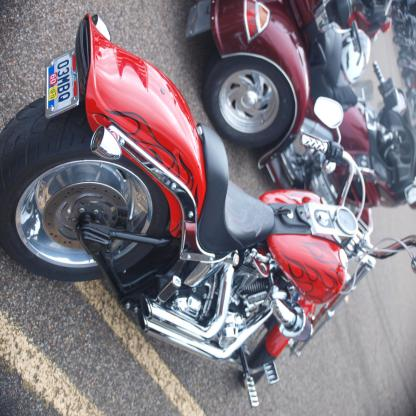

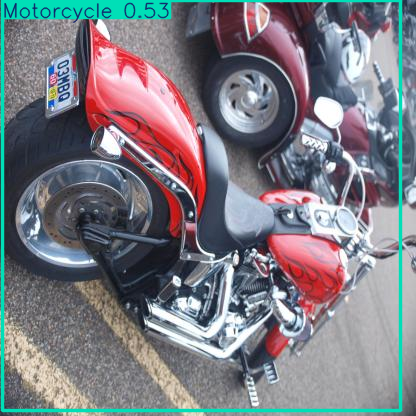


0: 416x416 (no detections), 295.8ms
Speed: 0.9ms preprocess, 295.8ms inference, 0.2ms postprocess per image at shape (1, 3, 416, 416)


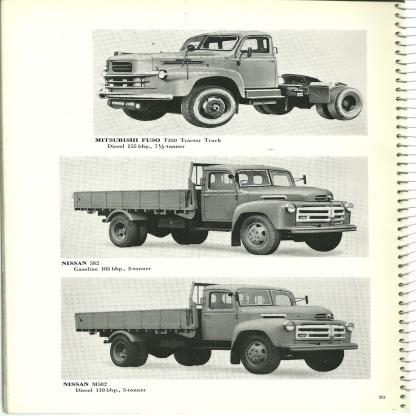

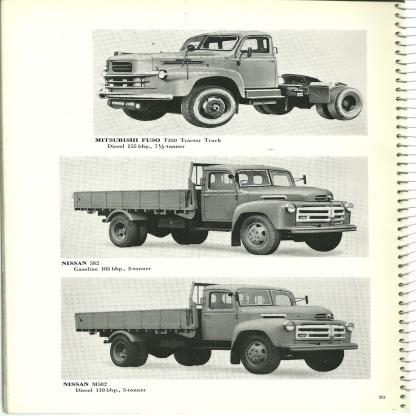


0: 416x416 1 Truck, 268.7ms
Speed: 2.8ms preprocess, 268.7ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 416)


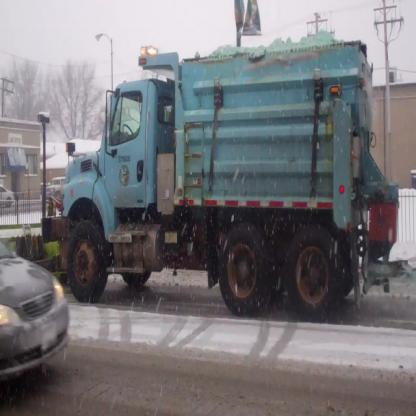

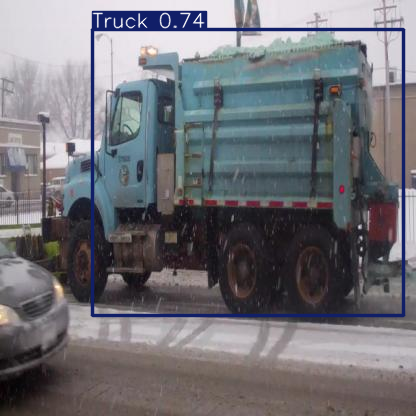


0: 416x416 1 Ambulance, 266.6ms
Speed: 1.0ms preprocess, 266.6ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 416)


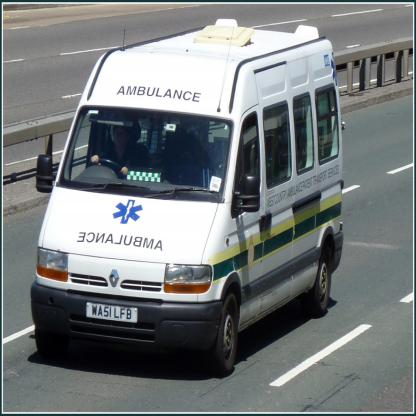

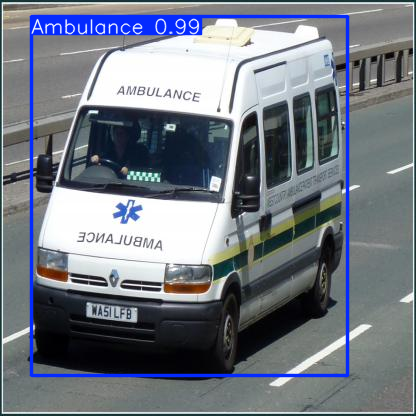


0: 416x416 1 Ambulance, 302.5ms
Speed: 0.9ms preprocess, 302.5ms inference, 0.4ms postprocess per image at shape (1, 3, 416, 416)


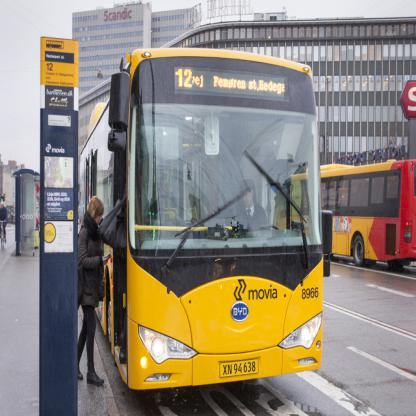

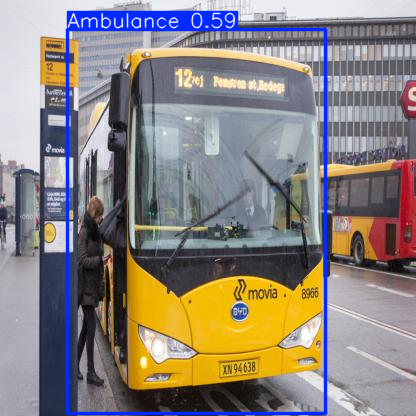


0: 416x416 (no detections), 313.6ms
Speed: 0.8ms preprocess, 313.6ms inference, 0.2ms postprocess per image at shape (1, 3, 416, 416)


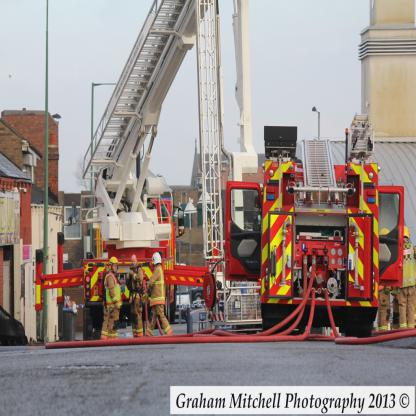

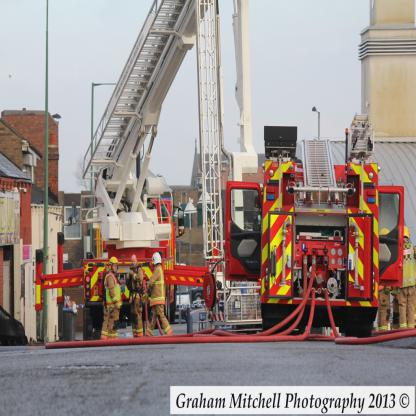


0: 416x416 (no detections), 316.8ms
Speed: 0.9ms preprocess, 316.8ms inference, 0.3ms postprocess per image at shape (1, 3, 416, 416)


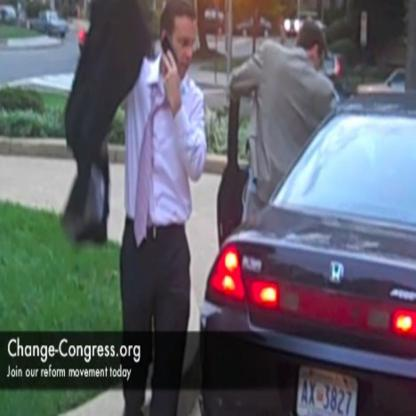

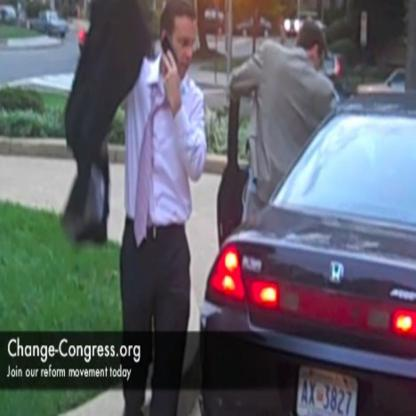


0: 416x416 2 Cars, 327.6ms
Speed: 1.1ms preprocess, 327.6ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 416)


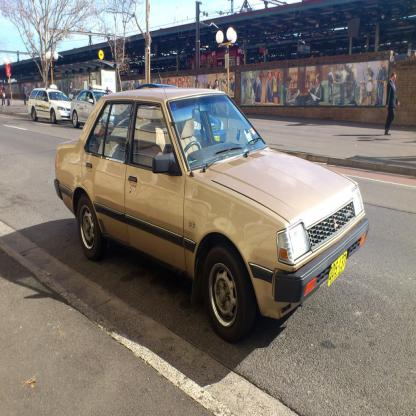

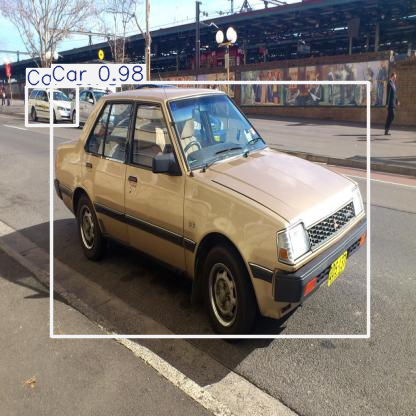


0: 416x416 1 Bus, 318.7ms
Speed: 0.8ms preprocess, 318.7ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 416)


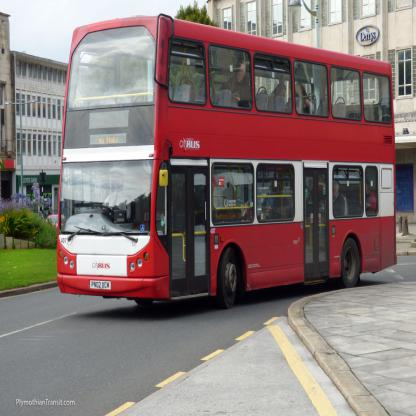

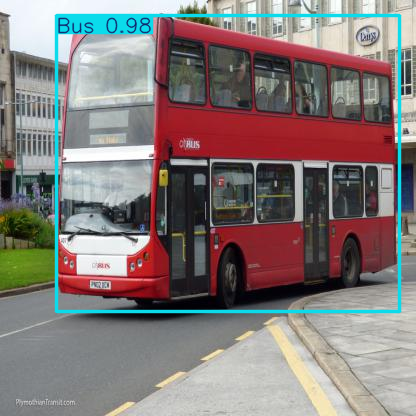


0: 416x416 1 Car, 339.6ms
Speed: 0.7ms preprocess, 339.6ms inference, 0.4ms postprocess per image at shape (1, 3, 416, 416)


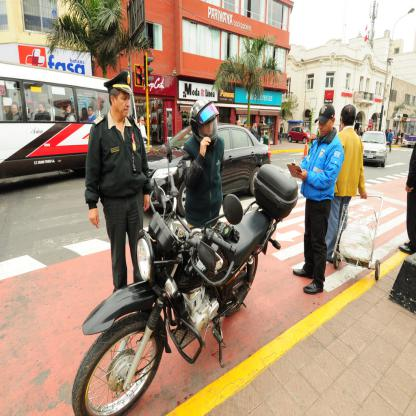

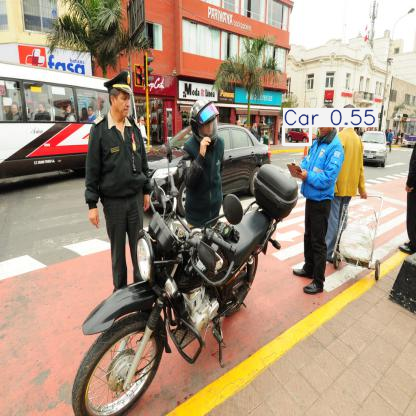

In [9]:
import os
import random
import mlflow
import cv2
import numpy as np
from PIL import Image
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO(r"C:\Users\arnav.shah\Desktop\Task2\yolo_model\best_yolo_v8L.pt")

# Define the test images directory
test_image_dir = r"C:\Users\arnav.shah\Desktop\VehiclesDetectionDataset\test\images"

# Get list of all test images
image_files = [os.path.join(test_image_dir, file) for file in os.listdir(test_image_dir) if file.endswith('.jpg')]

# Randomly select 10 images for testing
random_images = random.sample(image_files, k=10)

# Define the directory to save YOLO results
save_dir = r"C:\Users\arnav.shah\Desktop\YOLO_Test_Results"
os.makedirs(save_dir, exist_ok=True)

# Loop through the selected test images
for image_path in random_images:
    # Load image
    image = Image.open(image_path).convert('RGB')
    image_np = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)  # Convert for OpenCV processing

    # Perform object detection
    results = model.predict([image_np], save_dir=save_dir, imgsz=416, conf=0.5, iou=0.7)

    # Display original image
    display(image)

    # Convert and display detection results
    plot = results[0].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))




In [10]:
class YOLOv8Wrapper(mlflow.pyfunc.PythonModel):
    def load_context(self, context):
        from ultralytics import YOLO
        self.model = YOLO(r"C:\Users\arnav.shah\Desktop\Task2\mlruns\807863234713662408\506d1f1148b74d7caba3307c33e1ec7d\artifacts\weights\best.pt")

    def predict(self, context, model_input):
        from PIL import Image
        import numpy as np

        # Get the image path from the first row
        image_path = model_input["image"][0]

        # Open image from the path
        image = Image.open(image_path)
        image_np = np.array(image)

        # Run inference
        results = self.model(image_np)
        return results[0].tojson()



c:\Users\arnav.shah\AppData\Local\Programs\Python\Python313\Lib\site-packages\mlflow\pyfunc\utils\data_validation.py:168: UserWarning: Add type hints to the `predict` method to enable data validation and automatic signature inference during model logging. Check https://mlflow.org/docs/latest/model/python_model.html#type-hint-usage-in-pythonmodel for more details.
  color_warning(


registering the model with wrapper for serving


In [14]:
import mlflow
import mlflow.pyfunc
import pandas as pd
from PIL import Image

mlflow.set_tracking_uri("file:///C:/Users/arnav.shah/Desktop/Task2/mlruns")
mlflow.set_experiment("YOLOv8n1_Object_Detection")

with mlflow.start_run() as run:
    mlflow.pyfunc.log_model(
        artifact_path="yolo_model_serving",
        python_model=YOLOv8Wrapper(),
        artifacts={},
        conda_env=None,
    )
    print(f"Model logged at: runs:/{run.info.run_id}/yolo_model_serving")


2025/04/07 16:52:28 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Model logged at: runs:/c7b6da1d0e3d46cd82088dd4cd7fb8cb/yolo_model_serving


In [15]:
import requests

data = {
    "dataframe_records": [
        {"image": r"C:\Users\arnav.shah\Desktop\c1f88290d602f0e6_jpg.rf.ffe763bba24511dc402dcbac00b9ad34.jpg"}
    ]
}

response = requests.post(
    url="http://127.0.0.1:5001/invocations",
    json=data
)

print("Predictions:", response.json())


Predictions: {'predictions': '[\n  {\n    "name": "Car",\n    "class": 2,\n    "confidence": 0.90289,\n    "box": {\n      "x1": 29.46811,\n      "y1": 18.6925,\n      "x2": 391.76672,\n      "y2": 378.88184\n    }\n  },\n  {\n    "name": "Truck",\n    "class": 4,\n    "confidence": 0.26027,\n    "box": {\n      "x1": 8.15323,\n      "y1": 0.18909,\n      "x2": 416.0,\n      "y2": 159.16022\n    }\n  }\n]'}


In [65]:
from ultralytics import YOLO

# Define the local video file path
video_path = r"C:\Users\arnav.shah\Desktop\TrafficPolice.mp4"

# Run inference on the video
# The 'show' flag displays the video results, and 'save' saves the annotated video to the default save directory.
results = best_model.predict(source=video_path, show=False, save=True)

print("Inference results:", results)




WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/2362) C:\Users\arnav.shah\Desktop\TrafficPolice.mp4: 256x416 5 Cars, 39.6ms
video 1/1 (frame 2/2362) C:\Users\arnav.shah\Desktop\TrafficPolice.mp4: 256x416 7 Cars, 26.6ms
video 1/1 (frame 3/2362) C:\Users\arnav.shah\Desktop\TrafficPolice.mp4: 256x416 5 Cars, 22.5ms
video 1/1 (frame 4/2362) C:\Users\arnav.shah\Desktop\TrafficPolice.mp4: 256x416 8 Cars, 25.4ms
video 1/1 (frame 5/2362) C:\Users\arnav.shah\Desktop\TrafficPolice.mp4: 256x41